In [25]:
using Pkg
Pkg.add("TestImages")

  Resolving package versions...
  Installed TestImages ────── v1.3.1
  Installed StringDistances ─ v0.8.0
Updating `C:\Users\i am\.julia\environments\v1.5\Project.toml`
  [5e47fb64] + TestImages v1.3.1
Updating `C:\Users\i am\.julia\environments\v1.5\Manifest.toml`
  [88034a9c] + StringDistances v0.8.0
  [5e47fb64] + TestImages v1.3.1


In [4]:
using ArchGDAL, CSV, DataFrames
using ImageTransformations, CoordinateTransformations, Rotations, Plots

In [13]:
function closest_index(x::Array{T,1}, val::Q) where {T <: Number, Q <: Number}
    ibest = 1
    dxbest = abs(x[ibest]-val)
    for I in 1:length(x)
        dx = abs(x[I]-val)
        if dx < dxbest
            dxbest = dx
            ibest = I
        end
    end
    ibest
end
function closest_index(x::Array{T,1}, val::Array{Q,1}) where {T <: Number, Q <: Number}
    [closest_index(x,val[i]) for i in 1:length(val)]
end
function resize_cube(cube::Array{T,3},ratio) where T
	band1 = imresize(cube[:,:,1],ratio=ratio)
	cubeR = Array{typeof(band1[1]),3}(
		undef, 
		size(band1)[1],
		size(band1)[2],
		size(cube)[3]
	)
	cubeR[:,:,1]=band1
	for i in 2:size(cube)[3]
		cubeR[:,:,i] = imresize(cube[:,:,i],ratio=ratio)
	end
	cubeR
end
function resize_cube(cube::Array{T,2},ratio) where T
	imresize(cube,ratio=ratio)
end
function get_ranges(cube)
	minimums = Array{typeof(cube[1]),1}(undef,size(cube)[3])
	maximums = Array{typeof(cube[1]),1}(undef,size(cube)[3])
	for i in 1:size(cube)[3]
        try
            minimums[i] = minimum(filter(!iszero,cube[:,:,i]))
            #above errors if all elements are 0
        catch e
            println(e)
            minimums[i] = 0
        end            
		maximums[i] = maximum(cube[:,:,i])
	end
	[(minimums[i],maximums[i]) for i in 1:length(maximums)]
end

get_ranges (generic function with 1 method)

In [15]:
wvls = CSV.read("out/profiler_test_VNIR.wvl", DataFrame)
# parameters
tiff = "out/profiler_test_VNIR.tif"
bands = [4,5,6,7,8,9,10,55,21]
#####
dataset = ArchGDAL.read(tiff)
cube = Array{typeof(ArchGDAL.getband(dataset, 1)[1,1]),3}(
	undef,
	ArchGDAL.width(dataset),
	ArchGDAL.height(dataset), 
	length(bands)
)
for i in 1:length(bands)
	global cube[:,:,i] = ArchGDAL.getband(dataset, bands[i])
end

In [164]:
resized_cube = resize_cube(cube, 1/10)

122×120×9 Array{Float64,3}:
[:, :, 1] =
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  …  0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0     0.0  0.0  0.0  0.0  0.0  0.0  0.0
 0.0  0.0  0.0  0.0  0.0

In [165]:
ranges = get_ranges(resized_cube)

9-element Array{Tuple{Float64,Float64},1}:
 (0.053790983606546605, 38890.02535860656)
 (0.0035860655737690746, 37742.61142418034)
 (0.0028176229508169543, 36813.960297131154)
 (0.008452868852450862, 37905.89984631149)
 (0.003756830601087693, 37595.74795081968)
 (0.026895491803270156, 37849.70107581968)
 (0.019979508196718575, 38335.59246926231)
 (10.688012295079588, 40895.439634562834)
 (0.00034153005464069306, 36518.21567622952)

In [166]:
levels = ranges[2][1]:(ranges[2][2]-ranges[2][1])/5:ranges[2][2]

0.0035860655737690746:7548.521567622952:37742.61142418034

In [265]:
function contains_zero(arr)
    0 in arr
end
function M_iszero(x)
    iszero(x) || isnan(x)
end
function crop_out_zeros(band::Array{T,2}) where T
    width = size(band)[2]
    height = size(band)[1]
    #1 find how many rows we snip from 0
    UProws = 0
    i=1
    found= false
    while !found
        if count(!M_iszero,band[i,:])>0
            found = true
            UProws = i
        else
            i = i+1
        end
    end
    #2 find rows to snip from the bottom
    DOrows=0
    i=0
    found= false
    while !found
        if count(!M_iszero,band[height-i,:])>0
            found = true
            DOrows = i
        else
            i = i + 1
        end
    end
    #3 find cols to snip from the left
    Lcols=0
    i=1
    found= false
    while !found
        if count(!M_iszero,band[:,i])>0
            found = true
            Lcols = i
        else
            i = i+1
        end
    end
    #4 find cols to snip from the right
    Rcols=0
    i=0
    found= false
    while !found
        if count(!M_iszero,band[:,width-i])>0
            found = true
            Rcols = i
        else
            i = i+1
        end
    end
    #4 get cropped band
    band[UProws:(height-DOrows),Lcols:(width-Rcols)]
end

crop_out_zeros (generic function with 1 method)

In [266]:
resized_cube[1,2]

0x0000

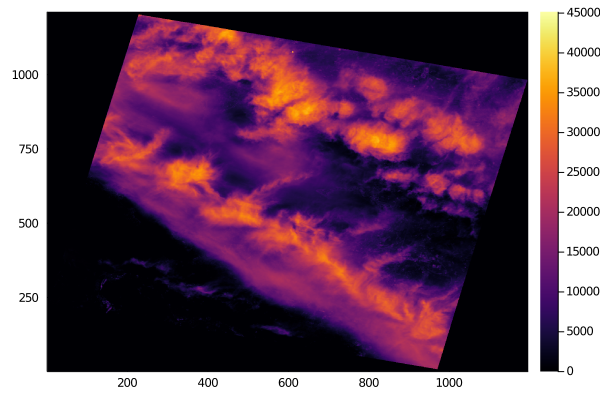

In [267]:
heatmap(cube[:,:,2])

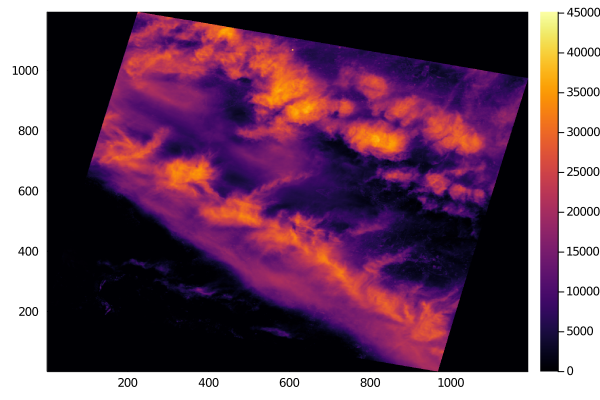

In [268]:
cropped_band = crop_out_zeros(cube[:,:,2])
heatmap(cropped_band)

In [325]:
function find_points_of_square(band::Array{T,2}) where T
	#A B
	#C D
	width = size(band)[2]
	height = size(band)[1]
	##########################	A
	i = 1
	found = false
	while i<width && !found
		if !M_iszero(band[1,i])
			found = true
		else
			i = i+1
		end
	end
	A = [1,i]
	##########################	B
	i = 1
	found = false
	while i<height && !found
		if !M_iszero(band[i,width])
			found = true
		else
			i = i+1
		end
	end
	B = [i, width]
	##########################	C
	i = 1
	found = false
	while i>height && !found
		if !M_iszero(band[i,1])
			found = true
		else
			i = i+1
		end
	end
	C = [height,i]
	##########################	D
	i = 1
	found = false
	while i<width && !found
		if !M_iszero(band[height,i])
			found = true
		else
			i = i+1
		end
	end
	D = [height,i]
	[A, B, C, D]
end
function find_points_of_square(cube::Array{T,3}) where T
	[find_points_of_square(cube[:,:,i]) for i in 1:size(cube)[3]]
end

find_points_of_square (generic function with 2 methods)

In [270]:
points =  [find_points_of_square(cropped_cube)]
first_e = points[1]

4-element Array{Array{Int64,1},1}:
 [1, 965]
 [973, 1190]
 [1194, 1]
 [1194, 224]

In [333]:
fix_points(first_e)

In [271]:
# check1, all points are same?
found_different = false
for i in points
    if i != first_e
        global found_different = true
    end
end
found_different

false

In [272]:
#check 2,  impossible points?
usable = [true for _ in points[1]]
max_width = size(cropped_cube)[2]
max_height = size(cropped_cube)[1]
for i in 1:length(points[1])
    if points[1][i][1] == max_height || points[1][i][1] == 1
        if points[1][i][2] == max_width || points[1][i][2] == 1
            usable[i] = false
        end
    end   
        
end
usable

4-element Array{Bool,1}:
 1
 1
 0
 1

In [273]:
#calculate bad points using good points
fixed = true
max_width = size(cropped_cube)[2]
max_height = size(cropped_cube)[1]
max_height, max_width

(1194, 1190)

In [274]:
#fixing A
if !usable[1]
    if !usable[4]
        fixed = false
    else
        first_e[1][2] = max_width - first_e[3][2]
    end
end
#fixing B
if !usable[2]
    if !usable[3]
        fixed = false
    else
        first_e[2][1] = max_height - first_e[3][1]
    end
end    
#fixing C
if !usable[3]
    if !usable[2]
        fixed = false
    else
        first_e[3][1] = max_height - first_e[2][1]
    end
end
#fixing D
if !usable[4]
    if !usable[1]
        fixed = false
    else
        first_e[4][2] = max_width - first_e[1][2]
    end
end
first_e

4-element Array{Array{Int64,1},1}:
 [1, 965]
 [973, 1190]
 [221, 1]
 [1194, 224]

In [275]:
fixed

true

In [310]:
resized_cube = cropped_cube
first_e

4-element Array{Array{Int64,1},1}:
 [1, 965]
 [973, 1190]
 [221, 1]
 [1194, 224]

In [371]:
opposite = first_e[1][2] - max_width
adjacent = first_e[2][1]
angle = cot(opposite/adjacent)
# define transformation
img = resized_cube[:,:]
trfm = recenter(RotMatrix(angle/π), ImageTransformations.center(img))
imgw = warp(img, trfm)

1444×1446 OffsetArray(::Array{Float64,2}, -124:1319, -127:1318) with eltype Float64 with indices -124:1319×-127:1318:
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  …  NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  …  NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  …  NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN

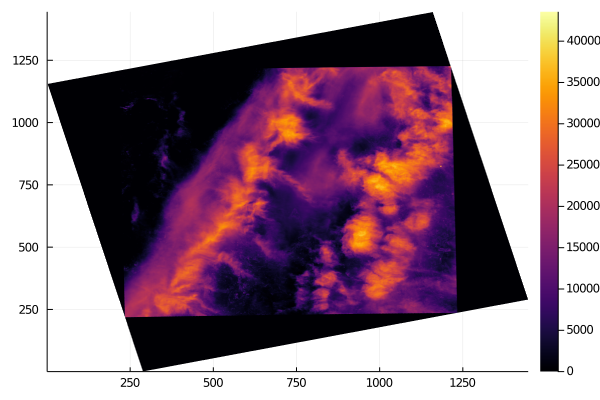

In [373]:
tilted_band = collect(imgw)
heatmap(tilted_band)

In [385]:
curated_band = crop_out_zeros(collect(imgw))

1011×1021 Array{Float64,2}:
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  …  NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  …  NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN  …  NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  NaN     NaN  NaN  NaN  NaN  NaN  NaN  NaN
 NaN  NaN  NaN  NaN  NaN  NaN  NaN  

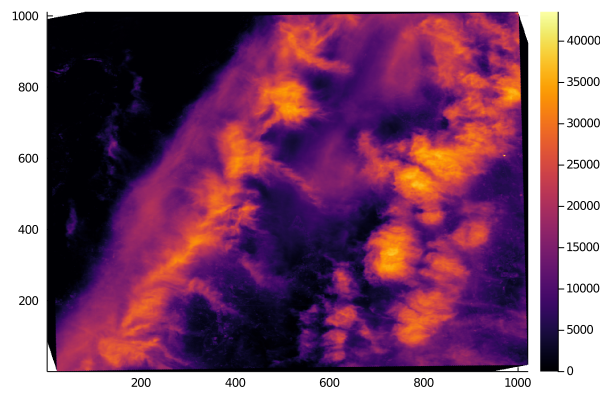

In [386]:
heatmap(curated_band)

In [387]:
# again
count(M_iszero,curated_band[1,:])

1014

In [388]:
count(M_iszero,curated_band[end,:])

1009

In [389]:
count(M_iszero,curated_band[:,end])

1010

In [390]:
count(M_iszero,curated_band[:,1])

1009

In [391]:
points2 = find_points_of_square(curated_band)

4-element Array{Array{Int64,1},1}:
 [1, 23]
 [20, 1021]
 [1011, 1]
 [1011, 955]

In [343]:
function fix_points(first_e::Array{Array{Int,1},1})
    usable = [true for _ in first_e]
    max_width = maximum([i[2] for i in first_e])
    max_height = maximum([i[1] for i in first_e])
    for i in 1:length(first_e)
        if first_e[i][1] == max_height || first_e[i][1] == 1
            if first_e[i][2] == max_width || first_e[i][2] == 1
                usable[i] = false
            end
        end 
    end
    
    fixed = true
    #fixing A
    if !usable[1]
        if !usable[4]
            fixed = false
        else
            first_e[1][2] = max_width - first_e[3][2]
        end
    end
    #fixing B
    if !usable[2]
        if !usable[3]
            fixed = false
        else
            first_e[2][1] = max_height - first_e[3][1]
        end
    end    
    #fixing C
    if !usable[3]
        if !usable[2]
            fixed = false
        else
            first_e[3][1] = max_height - first_e[2][1]
        end
    end
    #fixing D
    if !usable[4]
        if !usable[1]
            fixed = false
        else
            first_e[4][2] = max_width - first_e[1][2]
        end
    end
    first_e
end

fix_points (generic function with 2 methods)

In [392]:
points3 = fix_points(points2)

4-element Array{Array{Int64,1},1}:
 [1, 23]
 [20, 1021]
 [991, 1]
 [1011, 955]

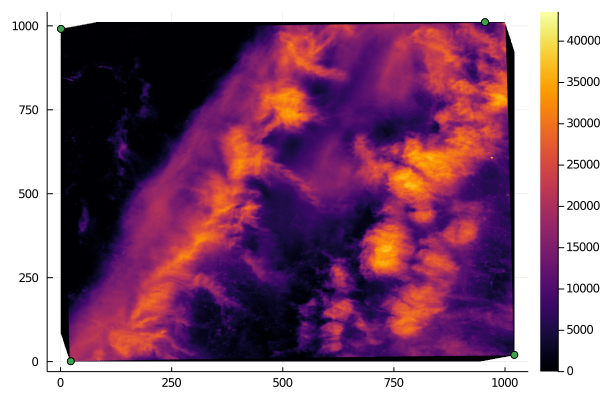

In [394]:
heatmap(curated_band)
scatter!([i[2] for i in points2],[i[1] for i in points2])
scatter!([i[2] for i in points3],[i[1] for i in points3],legend=false)

In [395]:
function calc_angles(points::Array{Array{Int,1},1})
    opposite = points[1][2]
    adjacent = points[3][1]
    cot(opposite/adjacent)
end

calc_angles (generic function with 1 method)

In [426]:
function find_points_of_square(band::Array{T,2}) where T
	#A B
	#C D
	width = size(band)[2]
	height = size(band)[1]
	##########################	A
	i = 1
	found = false
	while i<width && !found
		if !M_iszero(band[1,i])
			found = true
		else
			i = i+1
		end
	end
	A = [1,i]
	##########################	B
	i = 1
	found = false
	while i<height && !found
		if !M_iszero(band[i,width])
			found = true
		else
			i = i+1
		end
	end
	B = [i, width]
	##########################	C
	i = 1
	found = false
	while i>height && !found
		if !M_iszero(band[i,1])
			found = true
		else
			i = i+1
		end
	end
	C = [height,i]
	##########################	D
	i = 1
	found = false
	while i<width && !found
		if !M_iszero(band[height,i])
			found = true
		else
			i = i+1
		end
	end
	D = [height,i]
	[A, B, C, D]
end
function find_points_of_square(cube::Array{T,3}) where T
	[find_points_of_square(cube[:,:,i]) for i in 1:size(cube)[3]]
end
function tilt_band(band::Array{T,2}, angle::Float64) where T
    trfm = recenter(RotMatrix(-angle/π), ImageTransformations.center(band))
    collect(warp(band, trfm))
end

4-element Array{Array{Int64,1},1}:
 [1, 965]
 [973, 1190]
 [221, 1]
 [1194, 224]

In [451]:
s_cube = resize_cube(cube[:,:,2],2)
points4 = fix_points(find_points_of_square(crop_out_zeros(s_cube)))

4-element Array{Array{Int64,1},1}:
 [1, 1929]
 [1945, 2382]
 [445, 1]
 [2390, 447]

In [452]:
angle1 = calc_angle(points4)

4.215681061964384

In [453]:
first_fix = crop_out_zeros(tilt_band(s_cube,angle1))
heatmap(first_fix)

In [454]:
points5 = fix_points(find_points_of_square(first_fix))
heatmap(first_fix)
scatter!([i[2] for i in points5], [i[1] for i in points5], legend=false)

In [455]:
angle2 = calc_angle(points5)
second_fix = crop_out_zeros(tilt_band(first_fix,angle2))
heatmap(second_fix)

In [456]:
points5 = fix_points(find_points_of_square(second_fix))
heatmap(second_fix)
scatter!([i[2] for i in points5], [i[1] for i in points5], legend=false)

In [459]:
angle2 = calc_angle(points5)
third_fix = crop_out_zeros(tilt_band(second_fix,angle2))
heatmap(third_fix)